# NBA Players selection using Machine Learning

### Project Description

<p>
Consider that I am having a basketball team and want to select some good players for my team. I would like to perform the following;

<br>

* <b>Machine Learning Model 1:</b> Classifying the players who will be staying with the league for more than 5 years or less than that. <br>
* <b>Machine Learning Model 2:</b> Considering the players who are good as input, will be predicting their position in the basketball court. <br>
* <b>Machine Learning Model 3:</b> Based on the above outputs, this model will predict their salaries.<br>

* <b>Web App:</b> Building a web app using Angular as front end and Python REST as back end, in which the user or the coach has to load the csv file containing the player’s history and this system will run the input through all these models and will  finalize the players list who are required for the team with their respective salaries and positions in the basketball court.
</p>

### Data

Data for the above mentioned machine learning models are being collected from the following sites;

* https://data.world/
* https://www.basketball-reference.com/
* https://www.kaggle.com/felixdonovan/predicting-the-all-nba-teams/data

The collected data undergoes the following data preparation steps such as cleaning, standardization, missing value imputation and et cetera.

### Data Loading and Preprorcessing, Descriptive Statistics, Visualisation and Machine Learning model building

#### Libraries

In [233]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_score, recall_score, f1_score
from sklearn.feature_selection import VarianceThreshold
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn import preprocessing
from sklearn.multiclass import OneVsRestClassifier
import pickle

## for statistical tests
import scipy
import statsmodels.formula.api as smf
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from patsy import dmatrices

%matplotlib inline

## With Model 1 Data

In [2]:
ml_Model_1_Data = pd.read_csv("Data/nba_Longevity.csv")
ml_Model_1_Data.rename(columns ={"MIN":"MP","FGM":"FG","3P Made":"3P","FTM":"FT","OREB":"ORB","DREB":"DRB","REB":"TRB"},inplace=True)
ml_Model_1_Data.columns

Index(['Name', 'GP', 'MP', 'PTS', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', 'FT',
       'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV',
       'TARGET_5Yrs'],
      dtype='object')

In [3]:
ml_Model_1_Data['TARGET_5Yrs'] = ml_Model_1_Data['TARGET_5Yrs'].astype('int64')
ml_Model_1_Data

,Name,GP,MP,PTS,FG,FGA,FG%,3P,3PA,3P%,...,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,TARGET_5Yrs
0,Brandon Ingram,36,27.4,7.4,2.6,7.6,34.7,0.5,2.1,25.0,...,2.3,69.9,0.7,3.4,4.1,1.9,0.4,0.4,1.3,0
1,Andrew Harrison,35,26.9,7.2,2.0,6.7,29.6,0.7,2.8,23.5,...,3.4,76.5,0.5,2.0,2.4,3.7,1.1,0.5,1.6,0
2,JaKarr Sampson,74,15.3,5.2,2.0,4.7,42.2,0.4,1.7,24.4,...,1.3,67.0,0.5,1.7,2.2,1.0,0.5,0.3,1.0,0
3,Malik Sealy,58,11.6,5.7,2.3,5.5,42.6,0.1,0.5,22.6,...,1.3,68.9,1.0,0.9,1.9,0.8,0.6,0.1,1.0,1
4,Matt Geiger,48,11.5,4.5,1.6,3.0,52.4,0.0,0.1,0.0,...,1.9,67.4,1.0,1.5,2.5,0.3,0.3,0.4,0.8,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1335,Chris Smith,80,15.8,4.3,1.6,3.6,43.3,0.0,0.2,14.3,...,1.5,79.2,0.4,0.8,1.2,2.5,0.6,0.2,0.8,0
1336,Brent Price,68,12.6,3.9,1.5,4.1,35.8,0.1,0.7,16.7,...,1.0,79.4,0.4,1.1,1.5,2.3,0.8,0.0,1.3,1
1337,Marlon Maxey,43,12.1,5.4,2.2,3.9,55.0,0.0,0.0,0.0,...,1.6,64.3,1.5,2.3,3.8,0.3,0.3,0.4,0.9,0
1338,Litterial Green,52,12.0,4.5,1.7,3.8,43.9,0.0,0.2,10.0,...,1.8,62.5,0.2,0.4,0.7,2.2,0.4,0.1,0.8,1


In [4]:
#Checking for missing values
ml_Model_1_Data.isna().sum()

Name            0
GP              0
MP              0
PTS             0
FG              0
FGA             0
FG%             0
3P              0
3PA             0
3P%            11
FT              0
FTA             0
FT%             0
ORB             0
DRB             0
TRB             0
AST             0
STL             0
BLK             0
TOV             0
TARGET_5Yrs     0
dtype: int64

In [5]:
len(ml_Model_1_Data.index)

1340

In [6]:
ml_Model_1_Data = ml_Model_1_Data.dropna()

In [7]:
#Imputing Missing values
ml_Model_1_Data = ml_Model_1_Data.fillna(ml_Model_1_Data.mean())
ml_Model_1_Data.isna().sum()

Name           0
GP             0
MP             0
PTS            0
FG             0
FGA            0
FG%            0
3P             0
3PA            0
3P%            0
FT             0
FTA            0
FT%            0
ORB            0
DRB            0
TRB            0
AST            0
STL            0
BLK            0
TOV            0
TARGET_5Yrs    0
dtype: int64

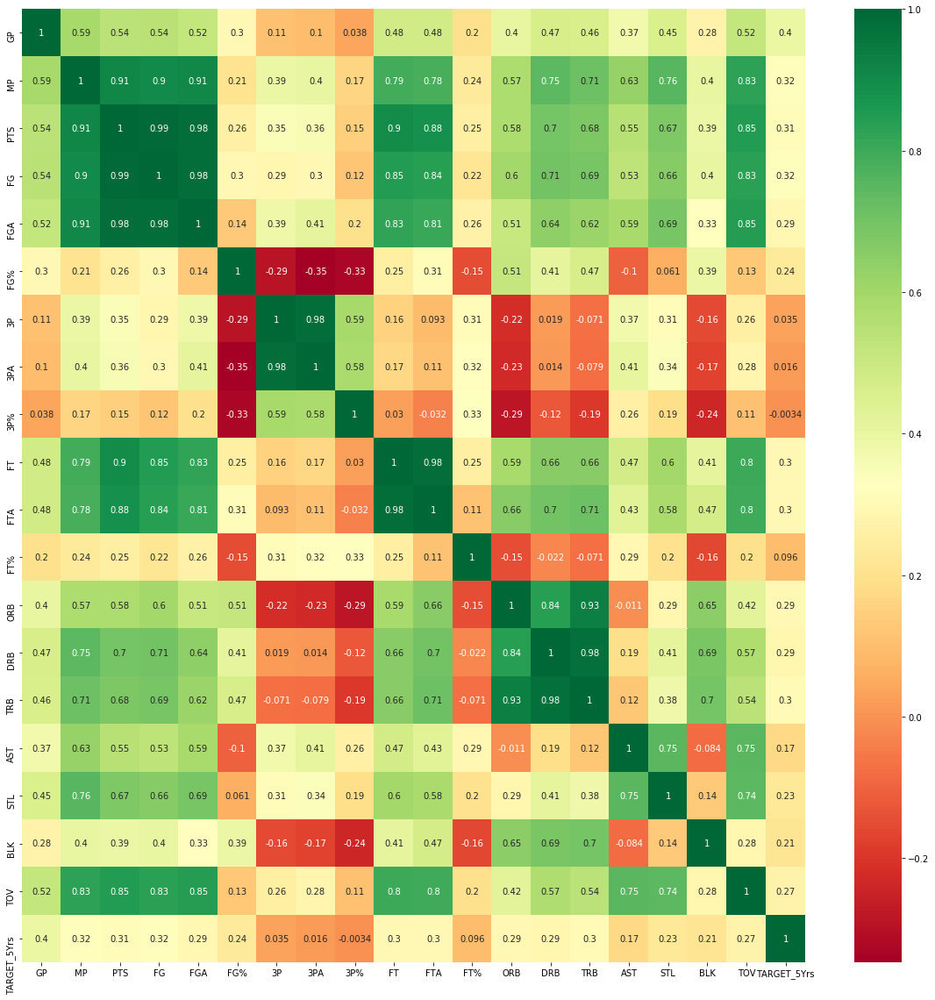

In [8]:
#Feature selection
correlation_Matrix_1 = ml_Model_1_Data.corr()
features_1 = correlation_Matrix_1.index
plt.figure(figsize=(20,20))
ml_1_data_heatMap = sns.heatmap(ml_Model_1_Data[features_1].corr(),annot=True,cmap="RdYlGn")

<p>
    From the above correlation heatmap last row, we could see that <b>GP (Games Played)</b> is correlated well with the target variable followed by <b>MP (Minutes Played), PTS (Points), FG (Field Goals), etc.</b>, but features such as <b>3P (3-Point Field Goals), 3PA (3-Point Field Goal Attempts)</b> and <b>3P% (3-Point Field Goal Percentage)</b> are less or negative correlated with target variable. The above mentioned highly correlated features might decrease the performance of classification algorithms. 
</p>
<br>
<p>
    But, I would like to run the classification algorithms with all features and only with selected features, compare their performance and select the model.
</p>

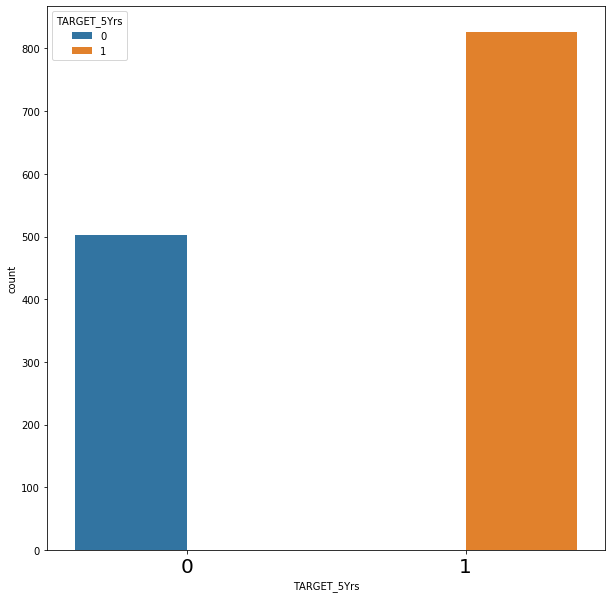

In [9]:
#Checking whether data are imbalanced or not
plt.figure(figsize=(10,10))
plt.rcParams["xtick.labelsize"] = 20
imbalance = sns.countplot(x='TARGET_5Yrs',hue="TARGET_5Yrs",data=ml_Model_1_Data)

From the above countplot, we could see that this dataset is imbalanced by having over <b>800</b> records for Yes i.e. 1 and <b>500</b> records for No i.e. 0

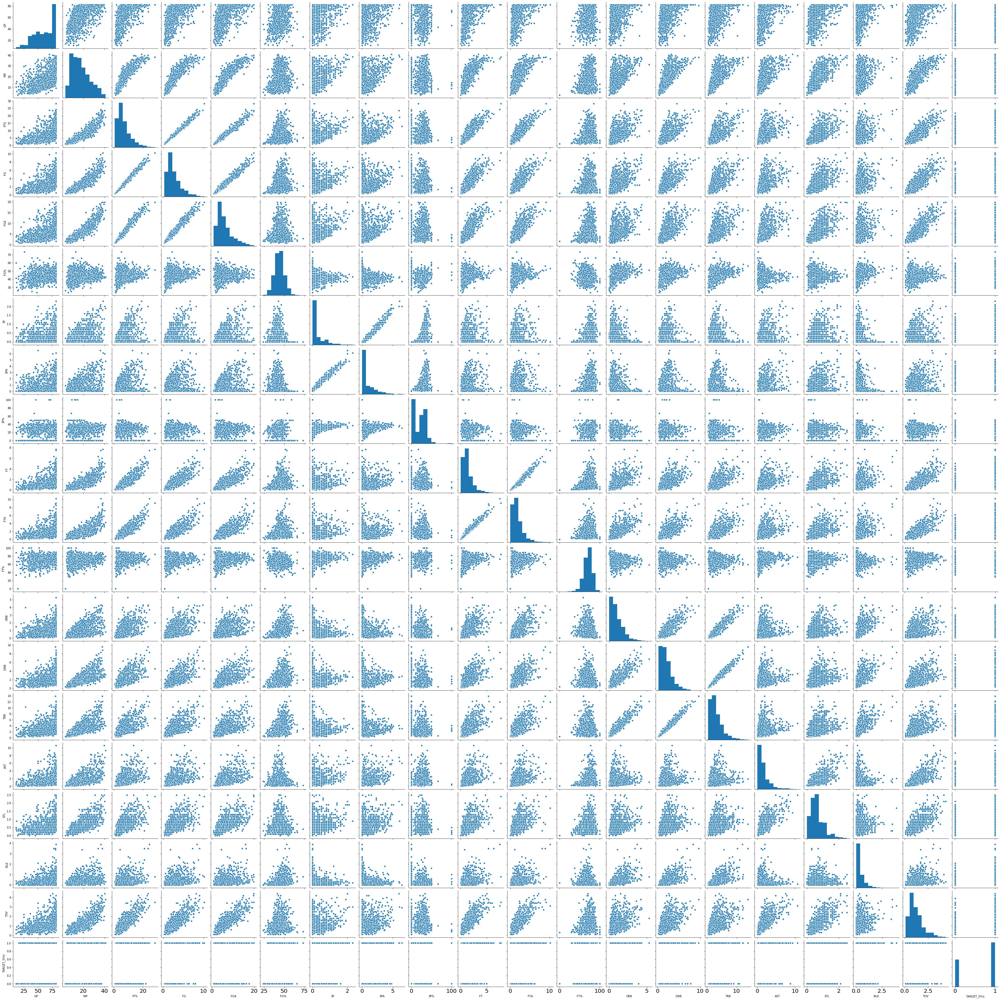

In [10]:
sns.pairplot(ml_Model_1_Data)

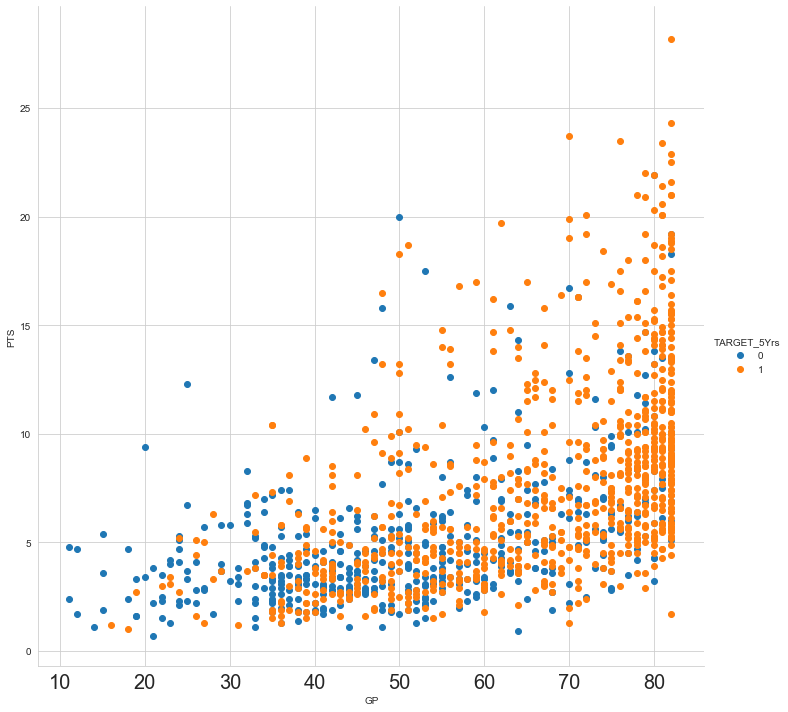

In [11]:
#Checking for linear separability
sns.set_style("whitegrid")
sns.FacetGrid(ml_Model_1_Data, hue="TARGET_5Yrs", height=10) \
   .map(plt.scatter, "GP", "PTS") \
   .add_legend()
plt.show()

<p>
    From the above plot, we can see two things; Firstly, the data is not linearly separable, hence we need to apply non-linear classification algorithms such as <b> SVM Kernel, k-nearest-neighbors (kNN), etc.</b>. Secondly, The players who stay with the league for more than 5 years have played more games and scored more points when compared with players who had stayed with the league for less than 5 years.
</p>

In [12]:
ml_Model_1_Data_With_All_Features = ml_Model_1_Data
ml_Model_1_Data_With_Selected_Features = ml_Model_1_Data

ml_Model_1_Data_With_Selected_Features = ml_Model_1_Data_With_Selected_Features.drop(['3P','3PA','3P%'],axis=1)

#Segregating dependent variable and independent variables
x1 = ml_Model_1_Data_With_All_Features.iloc[:,1:-1] #Independent variables.
y1 = ml_Model_1_Data_With_All_Features.iloc[:,-1] #Dependent or target variable.

x2 = ml_Model_1_Data_With_All_Features.iloc[:,1:-1] #Independent variables.
y2 = ml_Model_1_Data_With_All_Features.iloc[:,-1] #Dependent or target variable.

x3 = ml_Model_1_Data_With_Selected_Features.iloc[:,1:-1] #Independent variables.
y3 = ml_Model_1_Data_With_Selected_Features.iloc[:,-1] #Dependent or target variable.

In [ ]:
#Feature Selection
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

test = SelectKBest(score_func=chi2, k=10)
fit = test.fit(x2, y2)

# Summarize scores
np.set_printoptions(precision=3)
print(fit.scores_)

features = fit.transform(x2)
# Summarize selected features
print(features[0:10,:])

#GP, MP, PTS, FG, FGA, FT, FTA, ORB, DRB, TRB

In [13]:
x2 = x2.iloc[:,[0,1,2,3,4,9,10,12,13,14]]

In [14]:
#Splitting the data into train and test
X_train_1, X_test_1, Y_train_1, Y_test_1 = train_test_split(x1, y1, test_size=0.2, random_state=0)
X_train_2, X_test_2, Y_train_2, Y_test_2 = train_test_split(x2, y2, test_size=0.2, random_state=0)
X_train_3, X_test_3, Y_train_3, Y_test_3 = train_test_split(x3, y3, test_size=0.2, random_state=0)

In [ ]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(sampling_strategy='minority', random_state=27)
X_train_1,Y_train_1 = sm.fit_resample(X_train_1,Y_train_1)
X_train_3,Y_train_3 = sm.fit_resample(X_train_3,Y_train_3)
X_train_2,Y_train_2 = sm.fit_resample(X_train_2,Y_train_2)

In [ ]:
Y_train_1.value_counts()

In [15]:
#Scaling
sc_X_1 = StandardScaler()
X_train_1 = sc_X_1.fit_transform(X_train_1)
X_test_1 = sc_X_1.transform(X_test_1)

sc_X_3 = StandardScaler()
X_train_3 = sc_X_3.fit_transform(X_train_3)
X_test_3 = sc_X_3.transform(X_test_3)

sc_X_2 = StandardScaler()
X_train_2 = sc_X_2.fit_transform(X_train_2)
X_test_2 = sc_X_2.transform(X_test_2)

In [30]:
def accuracy(confusion_matrix):
    diagonal_sum = confusion_matrix.trace()
    sum_of_all_elements = confusion_matrix.sum()
    return diagonal_sum / sum_of_all_elements 

In [15]:
#Model Fitting
def SVMModel(X_train,X_test,Y_train,Y_test):
    svclassifier_1 = SVC(kernel='rbf',probability=True,C=1).fit(X_train, Y_train)
    probas_1 = svclassifier_1.predict_proba(X_train)
    probas_2 = svclassifier_1.predict_proba(X_test)

    #Prediction and evaluation
    Y_svm_pred_1 = svclassifier_1.predict(X_train)
    Y_svm_pred_2 = svclassifier_1.predict(X_test)
    
    print("\n###############Training######################\n")
    print("Confusion Matrix : \n", confusion_matrix(Y_train, Y_svm_pred_1))
    print("Accuracy: ",round(accuracy(confusion_matrix(Y_train, Y_svm_pred_1)),2))

    print('Precision : {}'.format(round(precision_score(Y_train, Y_svm_pred_1),3)))
    print('Recall    : {}'.format(round(recall_score(Y_train, Y_svm_pred_1),3)))
    print('F-score   : {}'.format(round(f1_score(Y_train, Y_svm_pred_1),3)))
    
    fpr_1, tpr_1, thresholds_1 = roc_curve(Y_train, probas_1[:, 1])
    roc_auc_1 = round(auc(fpr_1, tpr_1),2)
    print("\nArea under the ROC curve for train : %f" % roc_auc_1)

    print("\n###############Testing######################\n")
    print("Confusion Matrix : \n", confusion_matrix(Y_test, Y_svm_pred_2))
    print("Accuracy: ",round(accuracy(confusion_matrix(Y_test, Y_svm_pred_2)),2))

    print('Precision : {}'.format(round(precision_score(Y_test, Y_svm_pred_2),3)))
    print('Recall    : {}'.format(round(recall_score(Y_test, Y_svm_pred_2),3)))
    print('F-score   : {}'.format(round(f1_score(Y_test, Y_svm_pred_2),3)))
    
    fpr_2, tpr_2, thresholds_2 = roc_curve(Y_test, probas_2[:, 1])
    roc_auc_2 = round(auc(fpr_2, tpr_2),2)
    print("\nArea under the ROC curve for test : %f" % roc_auc_2)
    
    plt.clf()
    plt.figure(figsize=(7,7))
    plt.plot(fpr_1, tpr_1, label='Train ROC curve (area = %0.2f)' % roc_auc_1)
    plt.plot(fpr_2, tpr_2, label='Test ROC curve (area = %0.2f)' % roc_auc_2)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()
    
    return svclassifier_1

#### With all features


###############Training######################

Confusion Matrix : 
 [[220 179]
 [ 93 571]]
Accuracy:  0.74
Precision : 0.761
Recall    : 0.86
F-score   : 0.808

Area under the ROC curve for train : 0.800000

###############Testing######################

Confusion Matrix : 
 [[ 54  50]
 [ 26 136]]
Accuracy:  0.71
Precision : 0.731
Recall    : 0.84
F-score   : 0.782

Area under the ROC curve for test : 0.760000


<Figure size 432x288 with 0 Axes>

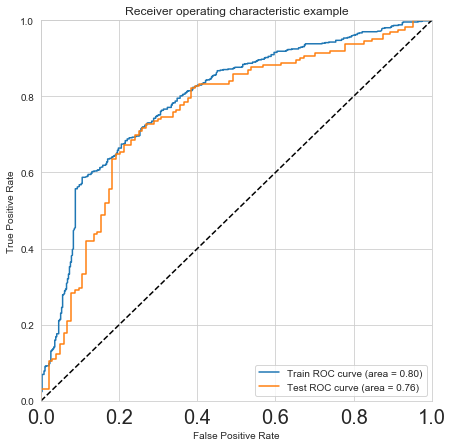

In [24]:
model_1_1 = SVMModel(X_train_1, X_test_1, Y_train_1, Y_test_1)

#### With selected features


###############Training######################

Confusion Matrix : 
 [[211 188]
 [102 562]]
Accuracy:  0.73
Precision : 0.749
Recall    : 0.846
F-score   : 0.795

Area under the ROC curve for train : 0.780000

###############Testing######################

Confusion Matrix : 
 [[ 54  50]
 [ 25 137]]
Accuracy:  0.72
Precision : 0.733
Recall    : 0.846
F-score   : 0.785

Area under the ROC curve for test : 0.750000


<Figure size 432x288 with 0 Axes>

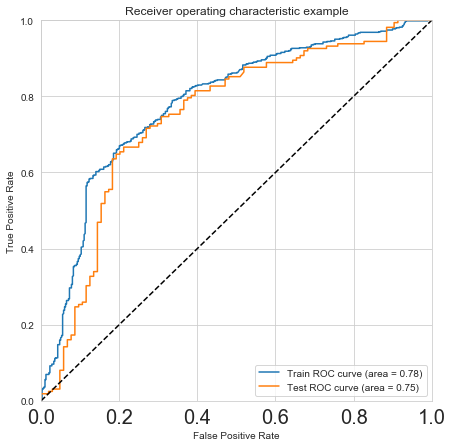

In [25]:
model_1_2 = SVMModel(X_train_3, X_test_3, Y_train_3, Y_test_3)

#### With features from feature selection


###############Training######################

Confusion Matrix : 
 [[210 189]
 [108 556]]
Accuracy:  0.72
Precision : 0.746
Recall    : 0.837
F-score   : 0.789

Area under the ROC curve for train : 0.760000

###############Testing######################

Confusion Matrix : 
 [[ 53  51]
 [ 25 137]]
Accuracy:  0.71
Precision : 0.729
Recall    : 0.846
F-score   : 0.783

Area under the ROC curve for test : 0.740000


<Figure size 432x288 with 0 Axes>

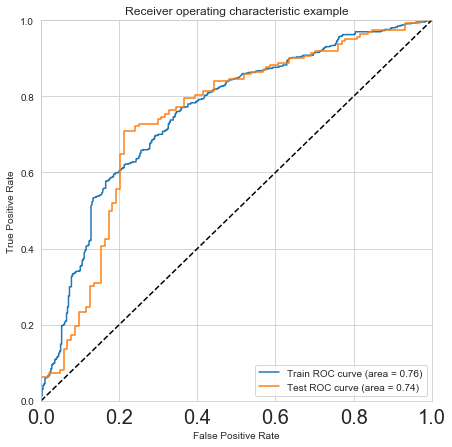

In [26]:
model_1_3 = SVMModel(X_train_2, X_test_2, Y_train_2, Y_test_2)

<img src="Docs/Depiction-of-a-ROC-Curve.jpg"></img>
<p>
    From the above AUC ROC curve plots (<b> with all features</b>, <b> With selected features based on domain knowledge </b> and <b> with features selected using feature selection techniques </b>), it can be seen that model performs better with all features than with selected features. Also comparing our AUC ROC curve plot(with all features) with the above theoritical AUC ROC curve, it can be seen that our model is a <b> skillful classifier </b>.
Since the dataset is imbalanced, we need to use different metrics to evaluate the model, hence I have chosen AUC ROC curve over accuracy. Based on the observation, I have found that AUC ROC value with all features is higher (<b>76% for test data and 80% for training data</b>) than the ROC value with selected features.
<br>
<br>
Moreover, we could see that the model's performance is average, this could be because of one of the following reasons:
    <br>
    <b>*</b> Imbalanced Dataset <br>
    <b>*</b> Small data size
</p>

#### Saving the model

In [148]:
filename = 'ML_Models/Career_Longevity.sav'
pickle.dump(model_1_1, open(filename, 'wb'))

NameError: name 'model_1_1' is not defined

## With Model 2 Data

In [293]:
seasons_Data = pd.read_csv("1990_2017_Season_Data.csv")
seasons_Data.columns

Index(['Unnamed: 0', 'Year', 'Player', 'Pos', 'Age', 'Tm', 'G', 'GS', 'MP',
       'PER', 'TS%', '3PAr', 'FTr', 'ORB%', 'DRB%', 'TRB%', 'AST%', 'STL%',
       'BLK%', 'TOV%', 'USG%', 'blanl', 'OWS', 'DWS', 'WS', 'WS/48', 'blank2',
       'OBPM', 'DBPM', 'BPM', 'VORP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%',
       '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB',
       'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS', 'Salary'],
      dtype='object')

In [294]:
#seasons_Data[['Pos']] = seasons_Data.Pos.str.split("-").str[0]
seasons_Data = seasons_Data[seasons_Data['Pos'].str.len()<=2]
seasons_Data['Pos'].value_counts()

PF    3162
PG    3050
C     3010
SG    2926
SF    2788
Name: Pos, dtype: int64

In [295]:
seasons_Data.drop(columns=['blanl','blank2','Unnamed: 0','Year','Player','Tm','Salary'],inplace=True,axis=1)
ml_Model_2_Data = seasons_Data
ml_Model_2_Data

,Pos,Age,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,C,27.0,80.0,50.0,1691.0,8.3,0.536,0.014,0.421,9.3,...,0.692,154.0,277.0,431.0,67.0,36.0,25.0,70.0,248.0,362.0
1,PG,27.0,79.0,74.0,2690.0,15.4,0.542,0.437,0.317,1.8,...,0.850,49.0,176.0,225.0,495.0,121.0,3.0,141.0,133.0,1221.0
2,SF,30.0,78.0,40.0,2005.0,15.8,0.544,0.104,0.283,6.7,...,0.756,117.0,188.0,305.0,145.0,34.0,19.0,121.0,201.0,1099.0
3,PG,30.0,75.0,68.0,2727.0,16.1,0.528,0.250,0.231,2.9,...,0.831,69.0,257.0,326.0,453.0,113.0,18.0,185.0,238.0,1342.0
4,PF,26.0,82.0,10.0,1893.0,14.1,0.510,0.062,0.169,8.5,...,0.812,151.0,223.0,374.0,142.0,60.0,39.0,101.0,219.0,860.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15112,PF,24.0,62.0,58.0,1725.0,16.7,0.604,0.002,0.442,8.6,...,0.679,135.0,270.0,405.0,99.0,62.0,58.0,65.0,189.0,639.0
15113,C,27.0,51.0,5.0,525.0,13.0,0.508,0.006,0.247,9.2,...,0.564,43.0,81.0,124.0,42.0,7.0,21.0,20.0,61.0,178.0
15114,C,20.0,19.0,0.0,108.0,7.3,0.346,0.000,0.161,10.8,...,0.600,11.0,24.0,35.0,4.0,2.0,5.0,3.0,17.0,23.0
15115,SF,22.0,44.0,18.0,843.0,6.9,0.503,0.448,0.181,1.9,...,0.775,15.0,110.0,125.0,36.0,15.0,16.0,40.0,78.0,240.0


In [296]:
#Checking for missing values
ml_Model_2_Data.isna().sum()

Pos         0
Age         0
G           0
GS          0
MP          0
PER         5
TS%        71
3PAr       80
FTr        80
ORB%        5
DRB%        5
TRB%        5
AST%        5
STL%        5
BLK%        5
TOV%       58
USG%        5
OWS         0
DWS         0
WS          0
WS/48       5
OBPM        0
DBPM        0
BPM         0
VORP        0
FG          0
FGA         0
FG%        80
3P          0
3PA         0
3P%      2666
2P          0
2PA         0
2P%       106
eFG%       80
FT          0
FTA         0
FT%       640
ORB         0
DRB         0
TRB         0
AST         0
STL         0
BLK         0
TOV         0
PF          0
PTS         0
dtype: int64

In [297]:
#Imputing Missing values
ml_Model_2_Data = ml_Model_2_Data.fillna(ml_Model_2_Data.median())
ml_Model_2_Data.isna().sum()

Pos      0
Age      0
G        0
GS       0
MP       0
PER      0
TS%      0
3PAr     0
FTr      0
ORB%     0
DRB%     0
TRB%     0
AST%     0
STL%     0
BLK%     0
TOV%     0
USG%     0
OWS      0
DWS      0
WS       0
WS/48    0
OBPM     0
DBPM     0
BPM      0
VORP     0
FG       0
FGA      0
FG%      0
3P       0
3PA      0
3P%      0
2P       0
2PA      0
2P%      0
eFG%     0
FT       0
FTA      0
FT%      0
ORB      0
DRB      0
TRB      0
AST      0
STL      0
BLK      0
TOV      0
PF       0
PTS      0
dtype: int64

In [265]:
len(ml_Model_2_Data.columns)

47

In [266]:
"""ml_Model_2_Data = ml_Model_2_Data[['Age', 'G', 'GS', 'MP', 'PER', 'TS%', '3PAr', 'FTr',
       'ORB%', 'DRB%', 'TRB%', 'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS',
       'DWS', 'WS', 'WS/48', 'OBPM', 'DBPM', 'BPM', 'VORP', 'FG', 'FGA', 'FG%',
       '3P', '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%',
       'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS','Pos']]"""
ml_Model_2_Data['Pos'] = ml_Model_2_Data.Pos.map(dict(SG=1, PG=2, PF=3, C=4, SF=5))
ml_Model_2_Data.columns

Index(['Pos', 'Age', 'G', 'GS', 'MP', 'PER', 'TS%', '3PAr', 'FTr', 'ORB%',
       'DRB%', 'TRB%', 'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS',
       'WS', 'WS/48', 'OBPM', 'DBPM', 'BPM', 'VORP', 'FG', 'FGA', 'FG%', '3P',
       '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB',
       'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS'],
      dtype='object')

In [298]:
ml_Model_2_Data['Pos'].value_counts()

PF    3162
PG    3050
C     3010
SG    2926
SF    2788
Name: Pos, dtype: int64

SG=1, PG=2, PF=3, C=4, SF=5


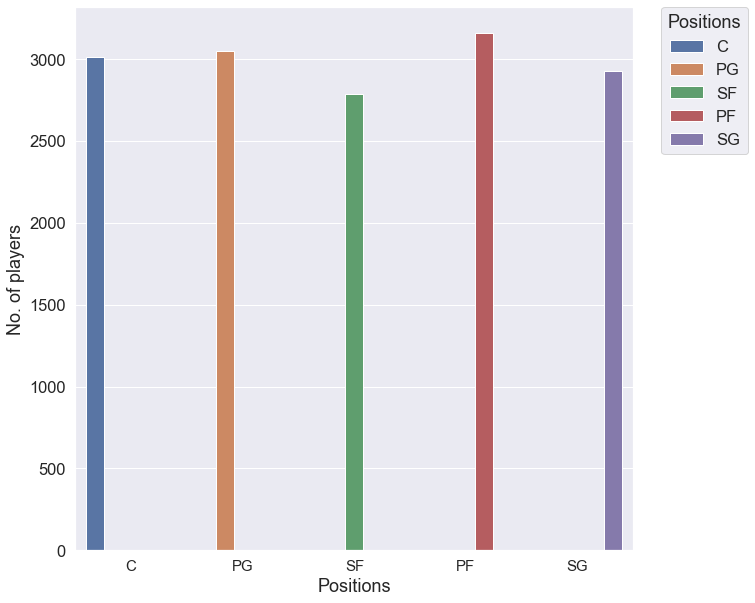

In [299]:
# Count of target labels and to check for imbalance dataset
plt.figure(figsize=(10,10))
sns.set(font_scale=1.5)
plt.rcParams["xtick.labelsize"] = 15
imbalance = sns.countplot(x='Pos',hue="Pos",data=ml_Model_2_Data)
imbalance.set(xlabel='Positions', ylabel='No. of players')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,title="Positions")
print("SG=1, PG=2, PF=3, C=4, SF=5")

###### From the above countplot, we could see that this dataset is not imbalanced which could make our model better in predicting positions of players

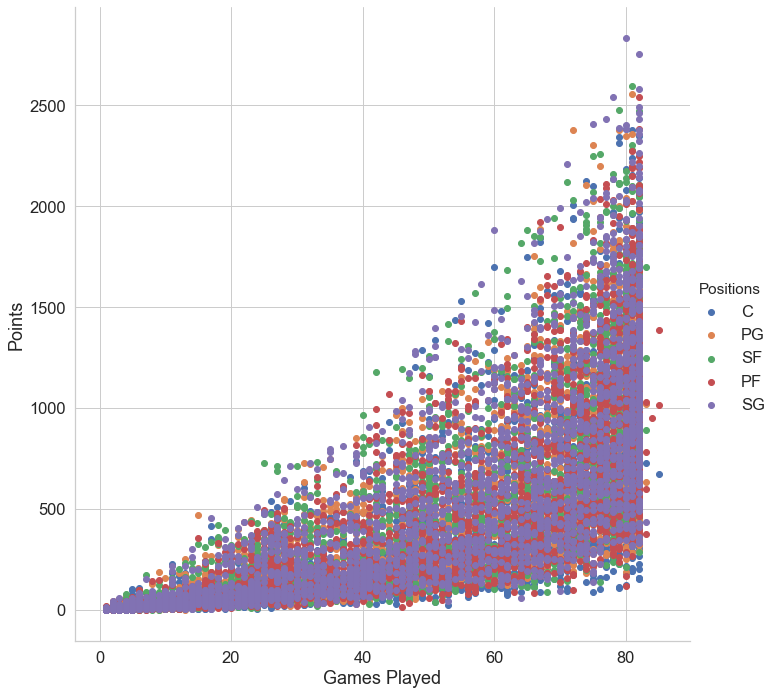

In [300]:
#Checking for linear separability
sns.set(font_scale=1.5)
sns.set_style("whitegrid")
sns.FacetGrid(ml_Model_2_Data, hue="Pos", height=10) \
   .map(plt.scatter, "G", "PTS") \
   .add_legend() \
   .set_axis_labels(x_var='Games Played', y_var='Points') \
   ._legend.set_title("Positions")
   #.axes[0,0].set_ylabel('axes label 1')
plt.show()

From the above plot, we can see two things; Firstly, the data is not linearly separable, hence we need to apply non-linear classification algorithms such as SVM Kernel, k-nearest-neighbors (kNN), etc.. Secondly, The players who have positions Small Forward (SF) have scored more scores in the number of games they have played.

In [13]:
sns.pairplot(ml_Model_2_Data)

In [301]:
#Segregating input and output data
# x = ml_Model_2_3_Data.iloc[:,1:-1]
# y = ml_Model_2_3_Data.iloc[:,-1]
b4_Ft_Selection = ml_Model_2_Data
X_train, X_test, Y_train, Y_test = train_test_split(b4_Ft_Selection.drop(labels = ['Pos'],axis=1), b4_Ft_Selection['Pos'], 
                                                    test_size=0.2, random_state=0)

#Scaling
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

In [302]:
#Model Fitting
from sklearn.neighbors import KNeighborsClassifier
def SVMModel2(X_train,X_test,Y_train,Y_test):
    
    #SVC(kernel='rbf',probability=True,C=1)
    """svclassifier_1 = SVC(C=100, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.001, kernel='rbf',
    max_iter=-1, probability=True, random_state=None, shrinking=True,
    tol=0.001, verbose=False).fit(X_train, Y_train)"""
    svclassifier_1 = SVC(kernel='rbf',probability=True,C=100,gamma=0.001).fit(X_train, Y_train)
    probas_1 = svclassifier_1.predict_proba(X_train)
    probas_2 = svclassifier_1.predict_proba(X_test)

    #Prediction and evaluation
    Y_svm_pred_1 = svclassifier_1.predict(X_train)
    Y_svm_pred_2 = svclassifier_1.predict(X_test)
    
    print("\n###############Training######################\n")
    print("Confusion Matrix : \n", confusion_matrix(Y_train, Y_svm_pred_1))
    print(metrics.classification_report(Y_train, Y_svm_pred_1,digits=2))

    print("\n###############Testing######################\n")
    print("Confusion Matrix : \n", confusion_matrix(Y_test, Y_svm_pred_2))    
    print(metrics.classification_report(Y_test, Y_svm_pred_2,digits=2))

    return svclassifier_1

In [303]:
model_2_1 = SVMModel2(X_train, X_test, Y_train, Y_test)


###############Training######################

Confusion Matrix : 
 [[1872  519    7   42   15]
 [ 645 1468   14  325   55]
 [   4    6 2085   21  282]
 [  81  330   45 1295  483]
 [  12   56  317  454 1515]]
              precision    recall  f1-score   support

           C       0.72      0.76      0.74      2455
          PF       0.62      0.59      0.60      2507
          PG       0.84      0.87      0.86      2398
          SF       0.61      0.58      0.59      2234
          SG       0.64      0.64      0.64      2354

    accuracy                           0.69     11948
   macro avg       0.69      0.69      0.69     11948
weighted avg       0.69      0.69      0.69     11948


###############Testing######################

Confusion Matrix : 
 [[419 121   1  13   1]
 [154 382   6  99  14]
 [  3   2 567  11  69]
 [ 17  91  13 314 119]
 [  4  15 100 104 349]]
              precision    recall  f1-score   support

           C       0.70      0.75      0.73       555
        

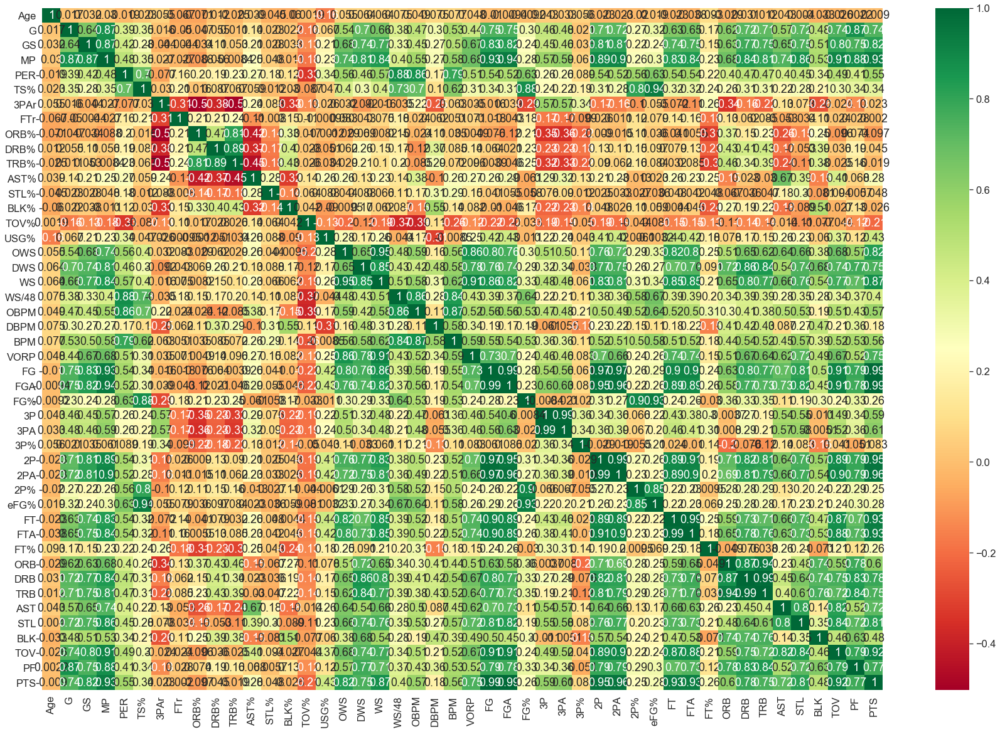

In [304]:
#Feature selection
correlation_Matrix_2 = ml_Model_2_Data.corr()
features_2 = correlation_Matrix_2.index
plt.figure(figsize=(30,20))
ml_2_data_heatMap = sns.heatmap(ml_Model_2_Data[features_2].corr(),annot=True,cmap="RdYlGn")

I think we cannot select the features which improves our model from the above visualization. Hence we need to select features using correlation matrix having correlation value above 0.5 and remove the irrelavant features from the data.

In [312]:
correlated_features = list()
for i in range(len(correlation_Matrix_2.columns)):
    for j in range(i):
        if abs(correlation_Matrix_2.iloc[i, j]) > 0.75:
            colname = correlation_Matrix_2.columns[i]
            correlated_features.append(colname)
correlated_features.append('Pos')
correlated_features = set(correlated_features)
print(correlated_features)

{'2P', 'FTA', 'WS/48', 'MP', '2P%', 'TRB%', 'WS', 'FGA', 'PTS', 'eFG%', 'BPM', 'VORP', '3PA', 'DWS', 'FG', 'FT', 'STL', 'OBPM', 'FG%', 'BLK', 'DRB', 'Pos', 'TOV', 'PF', 'TRB', '2PA'}


In [313]:
correlated_Independent_Data = ml_Model_2_Data
correlated_Independent_Data = correlated_Independent_Data[correlated_features]

In [314]:
temp_data = correlated_Independent_Data
X_train, X_test, Y_train, Y_test = train_test_split(temp_data.drop(labels = ['Pos'],axis=1), temp_data['Pos'], 
                                                    test_size=0.2, random_state=0)

#Scaling
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

In [315]:
model_2_2 = SVMModel2(X_train, X_test, Y_train, Y_test)


###############Training######################

Confusion Matrix : 
 [[1850  503   36   37   29]
 [ 799 1284   37  322   65]
 [  13   12 1988   54  331]
 [ 121  331  122 1099  561]
 [  37   57  514  416 1330]]
              precision    recall  f1-score   support

           C       0.66      0.75      0.70      2455
          PF       0.59      0.51      0.55      2507
          PG       0.74      0.83      0.78      2398
          SF       0.57      0.49      0.53      2234
          SG       0.57      0.56      0.57      2354

    accuracy                           0.63     11948
   macro avg       0.62      0.63      0.63     11948
weighted avg       0.63      0.63      0.63     11948


###############Testing######################

Confusion Matrix : 
 [[417 114   4  15   5]
 [201 330  11 100  13]
 [  7   3 531  18  93]
 [ 27  82  30 271 144]
 [ 10  13 152  99 298]]
              precision    recall  f1-score   support

           C       0.63      0.75      0.69       555
        

In [317]:
#Feature selection from domain knowledge
features = ['PTS','TS%','ORB','DRB','TRB','AST','BLK','TOV','USG%','OWS','DWS','WS','STL','Pos']
feature_dataset = ml_Model_2_Data[features]
feature_dataset.head

<bound method NDFrame.head of           PTS    TS%    ORB    DRB    TRB    AST   BLK    TOV  USG%  OWS  DWS  \
0       362.0  0.536  154.0  277.0  431.0   67.0  25.0   70.0   9.4  1.1  0.6   
1      1221.0  0.542   49.0  176.0  225.0  495.0   3.0  141.0  18.5  4.4  2.5   
2      1099.0  0.544  117.0  188.0  305.0  145.0  19.0  121.0  24.3  3.1  2.5   
3      1342.0  0.528   69.0  257.0  326.0  453.0  18.0  185.0  23.0  2.7  2.1   
4       860.0  0.510  151.0  223.0  374.0  142.0  39.0  101.0  20.4  1.5  1.6   
...       ...    ...    ...    ...    ...    ...   ...    ...   ...  ...  ...   
15112   639.0  0.604  135.0  270.0  405.0   99.0  58.0   65.0  15.5  3.4  2.2   
15113   178.0  0.508   43.0   81.0  124.0   42.0  21.0   20.0  16.5  0.5  0.6   
15114    23.0  0.346   11.0   24.0   35.0    4.0   5.0    3.0  14.8 -0.1  0.1   
15115   240.0  0.503   15.0  110.0  125.0   36.0  16.0   40.0  14.4 -0.3  0.8   
15116   284.0  0.547   41.0  118.0  159.0   30.0  33.0   30.0  20.3  0.6  0.5  

In [318]:
temp_data = feature_dataset
X_train, X_test, Y_train, Y_test = train_test_split(temp_data.drop(labels = ['Pos'],axis=1), temp_data['Pos'], 
                                                    test_size=0.2, random_state=0)

#Scaling
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

In [319]:
model_2_3 = SVMModel2(X_train, X_test, Y_train, Y_test)


###############Training######################

Confusion Matrix : 
 [[1405  878    7   30  135]
 [ 539 1522   21  220  205]
 [  39   33 1994    8  324]
 [  98  504   67  863  702]
 [  45  120  397  312 1480]]
              precision    recall  f1-score   support

           C       0.66      0.57      0.61      2455
          PF       0.50      0.61      0.55      2507
          PG       0.80      0.83      0.82      2398
          SF       0.60      0.39      0.47      2234
          SG       0.52      0.63      0.57      2354

    accuracy                           0.61     11948
   macro avg       0.62      0.61      0.60     11948
weighted avg       0.62      0.61      0.60     11948


###############Testing######################

Confusion Matrix : 
 [[323 198   1   7  26]
 [141 396   2  74  42]
 [ 17   9 539   2  85]
 [ 24 128  18 215 169]
 [ 13  27 118  72 342]]
              precision    recall  f1-score   support

           C       0.62      0.58      0.60       555
        

## With Model 3 Data

In [60]:
seasons_Stats_1990_2017 = pd.read_csv("1990_2017_Season_Data.csv")

In [61]:
seasons_Stats_1990_2017.shape

(15117, 54)

In [62]:
seasons_Stats_1990_2017 = seasons_Stats_1990_2017.drop(labels = ['Unnamed: 0','blanl','blank2',"Year","Tm","Player"],axis=1)

In [63]:
seasons_Stats_1990_2017.columns

Index(['Pos', 'Age', 'G', 'GS', 'MP', 'PER', 'TS%', '3PAr', 'FTr', 'ORB%',
       'DRB%', 'TRB%', 'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS',
       'WS', 'WS/48', 'OBPM', 'DBPM', 'BPM', 'VORP', 'FG', 'FGA', 'FG%', '3P',
       '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB',
       'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS', 'Salary'],
      dtype='object')

In [64]:
seasons_Stats_1990_2017.isna().sum()

Pos          0
Age          0
G            0
GS           0
MP           0
PER          5
TS%         71
3PAr        80
FTr         80
ORB%         5
DRB%         5
TRB%         5
AST%         5
STL%         5
BLK%         5
TOV%        58
USG%         5
OWS          0
DWS          0
WS           0
WS/48        5
OBPM         0
DBPM         0
BPM          0
VORP         0
FG           0
FGA          0
FG%         80
3P           0
3PA          0
3P%       2686
2P           0
2PA          0
2P%        106
eFG%        80
FT           0
FTA          0
FT%        643
ORB          0
DRB          0
TRB          0
AST          0
STL          0
BLK          0
TOV          0
PF           0
PTS          0
Salary       0
dtype: int64

In [65]:
seasons_Stats_1990_2017 = seasons_Stats_1990_2017.fillna(seasons_Stats_1990_2017.median())
seasons_Stats_1990_2017.isna().sum()

Pos       0
Age       0
G         0
GS        0
MP        0
PER       0
TS%       0
3PAr      0
FTr       0
ORB%      0
DRB%      0
TRB%      0
AST%      0
STL%      0
BLK%      0
TOV%      0
USG%      0
OWS       0
DWS       0
WS        0
WS/48     0
OBPM      0
DBPM      0
BPM       0
VORP      0
FG        0
FGA       0
FG%       0
3P        0
3PA       0
3P%       0
2P        0
2PA       0
2P%       0
eFG%      0
FT        0
FTA       0
FT%       0
ORB       0
DRB       0
TRB       0
AST       0
STL       0
BLK       0
TOV       0
PF        0
PTS       0
Salary    0
dtype: int64

In [66]:
seasons_Stats_1990_2017.head()

,Pos,Age,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Salary
0,C,27.0,80.0,50.0,1691.0,8.3,0.536,0.014,0.421,9.3,...,154.0,277.0,431.0,67.0,36.0,25.0,70.0,248.0,362.0,437000
1,PG,27.0,79.0,74.0,2690.0,15.4,0.542,0.437,0.317,1.8,...,49.0,176.0,225.0,495.0,121.0,3.0,141.0,133.0,1221.0,825000
2,SF,30.0,78.0,40.0,2005.0,15.8,0.544,0.104,0.283,6.7,...,117.0,188.0,305.0,145.0,34.0,19.0,121.0,201.0,1099.0,1115000
3,PG,30.0,75.0,68.0,2727.0,16.1,0.528,0.250,0.231,2.9,...,69.0,257.0,326.0,453.0,113.0,18.0,185.0,238.0,1342.0,725000
4,PF,26.0,82.0,10.0,1893.0,14.1,0.510,0.062,0.169,8.5,...,151.0,223.0,374.0,142.0,60.0,39.0,101.0,219.0,860.0,500000


In [67]:
seasons_Stats_1990_2017['Pos'].value_counts()

PF       3162
PG       3050
C        3010
SG       2926
SF       2788
PG-SG      27
SG-SF      24
C-PF       23
SF-SG      22
SG-PG      22
PF-SF      21
PF-C       20
SF-PF      17
SG-PF       3
C-SF        1
PG-SF       1
Name: Pos, dtype: int64

In [74]:
ml_Model_3_Data = seasons_Stats_1990_2017[(seasons_Stats_1990_2017.Pos.str.len()<=2)]

In [78]:
ml_Model_3_Data['Pos'].value_counts()

PF    3162
PG    3050
C     3010
SG    2926
SF    2788
Name: Pos, dtype: int64

In [79]:
ml_Model_3_Data.shape

(14936, 48)

In [113]:
working_ml_Model_3_Data = ml_Model_3_Data

In [114]:
working_ml_Model_3_Data = pd.concat([ml_Model_3_Data,pd.get_dummies(working_ml_Model_3_Data['Pos'],prefix="position")],axis=1)

In [115]:
working_ml_Model_3_Data.drop(['Pos'],axis=1, inplace=True)

In [116]:
working_ml_Model_3_Data.head()

,Age,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,DRB%,...,BLK,TOV,PF,PTS,Salary,position_C,position_PF,position_PG,position_SF,position_SG
0,27.0,80.0,50.0,1691.0,8.3,0.536,0.014,0.421,9.3,17.8,...,25.0,70.0,248.0,362.0,437000,1,0,0,0,0
1,27.0,79.0,74.0,2690.0,15.4,0.542,0.437,0.317,1.8,7.3,...,3.0,141.0,133.0,1221.0,825000,0,0,1,0,0
2,30.0,78.0,40.0,2005.0,15.8,0.544,0.104,0.283,6.7,10.6,...,19.0,121.0,201.0,1099.0,1115000,0,0,0,1,0
3,30.0,75.0,68.0,2727.0,16.1,0.528,0.250,0.231,2.9,10.6,...,18.0,185.0,238.0,1342.0,725000,0,0,1,0,0
4,26.0,82.0,10.0,1893.0,14.1,0.510,0.062,0.169,8.5,12.8,...,39.0,101.0,219.0,860.0,500000,0,1,0,0,0


In [117]:
working_ml_Model_3_Data_Renamed = working_ml_Model_3_Data
working_ml_Model_3_Data_Renamed.rename(columns={"WS/48":"WS48","TS%":"TSPerc","ORB%":"ORBPerc",
"DRB%":"DRBPerc","TRB%":"TRBPerc","AST%":"ASTPerc","STL%":"STLPerc","BLK%":"BLKPerc",
"TOV%":"TOVPerc","USG%":"USGPerc","FG%":"FGPerc","3P%":"threePtPerc","2P%":"twoPtPPerc",
"eFG%":"eFGPerc","FT%":"FTPerc","3PAr":"threePAr","3P":"threePts","3PA":"threePtAttempts",
"2P":"twoPts","2PA":"twoPtAttempts"},inplace=True)

In [118]:
working_ml_Model_3_Data_Renamed.columns

Index(['Age', 'G', 'GS', 'MP', 'PER', 'TSPerc', 'threePAr', 'FTr', 'ORBPerc',
       'DRBPerc', 'TRBPerc', 'ASTPerc', 'STLPerc', 'BLKPerc', 'TOVPerc',
       'USGPerc', 'OWS', 'DWS', 'WS', 'WS48', 'OBPM', 'DBPM', 'BPM', 'VORP',
       'FG', 'FGA', 'FGPerc', 'threePts', 'threePtAttempts', 'threePtPerc',
       'twoPts', 'twoPtAttempts', 'twoPtPPerc', 'eFGPerc', 'FT', 'FTA',
       'FTPerc', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS',
       'Salary', 'position_C', 'position_PF', 'position_PG', 'position_SF',
       'position_SG'],
      dtype='object')

In [87]:
def vif_Calculate(dataset):
    mCols = dataset.columns.tolist()
    mCols.remove("Salary")
    y, X = dmatrices('Salary ~'+ "+".join(mCols), data=dataset, return_type='dataframe')

    vif = pd.DataFrame()
    vif['variable'] = X.columns
    vif['VIF'] = [round(variance_inflation_factor(X.values, i),0) for i in range(X.shape[1])]

    #view VIF for each explanatory variable 
    return vif

In [81]:
#Feature selection
def correlationPlot(dataSet):
    correlation_Matrix_3 = dataSet.corr()
    features_3 = correlation_Matrix_3.index
    plt.figure(figsize=(30,20))
    ml_3_data_heatMap = sns.heatmap(dataSet[features_3].corr(),annot=True,cmap="RdYlGn")

In [174]:
# As per two research papers, the following are the determinants which can be used to predict salary of a NBA Player
determinants_and_target = ['MP','PER','3P','2P','FT','ORB','DRB','AST','STL','BLK','TOV','PF','Pos',"Salary"]
ml_Model_3_Data_With_Selected_Features = ml_Model_3_Data[determinants_and_target]
ml_Model_3_Data_With_Selected_Features = pd.concat([ml_Model_3_Data_With_Selected_Features,pd.get_dummies(ml_Model_3_Data_With_Selected_Features['Pos'],prefix="position")],axis=1)
ml_Model_3_Data_With_Selected_Features.drop(['Pos'],axis=1, inplace=True)
ml_Model_3_Data_With_Selected_Features.head()

,MP,PER,3P,2P,FT,ORB,DRB,AST,STL,BLK,TOV,PF,Salary,position_C,position_PF,position_PG,position_SF,position_SG
0,1691.0,8.3,3.0,135.0,83.0,154.0,277.0,67.0,36.0,25.0,70.0,248.0,437000,1,0,0,0,0
1,2690.0,15.4,158.0,240.0,267.0,49.0,176.0,495.0,121.0,3.0,141.0,133.0,825000,0,0,1,0,0
2,2005.0,15.8,31.0,407.0,192.0,117.0,188.0,145.0,34.0,19.0,121.0,201.0,1115000,0,0,0,1,0
3,2727.0,16.1,108.0,398.0,222.0,69.0,257.0,453.0,113.0,18.0,185.0,238.0,725000,0,0,1,0,0
4,1893.0,14.1,10.0,361.0,108.0,151.0,223.0,142.0,60.0,39.0,101.0,219.0,500000,0,1,0,0,0


In [82]:
#Data distribution
def pairPlot(dataSet):
    sns.set(font_scale=1.5)
    sns.pairplot(dataSet)

In [136]:
ml_Model_3_Data_With_Selected_Features.iloc[:,0:13]

,MP,PER,3P,2P,FT,ORB,DRB,AST,STL,BLK,TOV,PF,Salary
0,1691.0,8.3,3.0,135.0,83.0,154.0,277.0,67.0,36.0,25.0,70.0,248.0,437000
1,2690.0,15.4,158.0,240.0,267.0,49.0,176.0,495.0,121.0,3.0,141.0,133.0,825000
2,2005.0,15.8,31.0,407.0,192.0,117.0,188.0,145.0,34.0,19.0,121.0,201.0,1115000
3,2727.0,16.1,108.0,398.0,222.0,69.0,257.0,453.0,113.0,18.0,185.0,238.0,725000
4,1893.0,14.1,10.0,361.0,108.0,151.0,223.0,142.0,60.0,39.0,101.0,219.0,500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15112,1725.0,16.7,0.0,253.0,133.0,135.0,270.0,99.0,62.0,58.0,65.0,189.0,5318313
15113,525.0,13.0,0.0,78.0,22.0,43.0,81.0,42.0,7.0,21.0,20.0,61.0,8000000
15114,108.0,7.3,0.0,10.0,3.0,11.0,24.0,4.0,2.0,5.0,3.0,17.0,950000
15115,843.0,6.9,33.0,55.0,31.0,15.0,110.0,36.0,15.0,16.0,40.0,78.0,750000


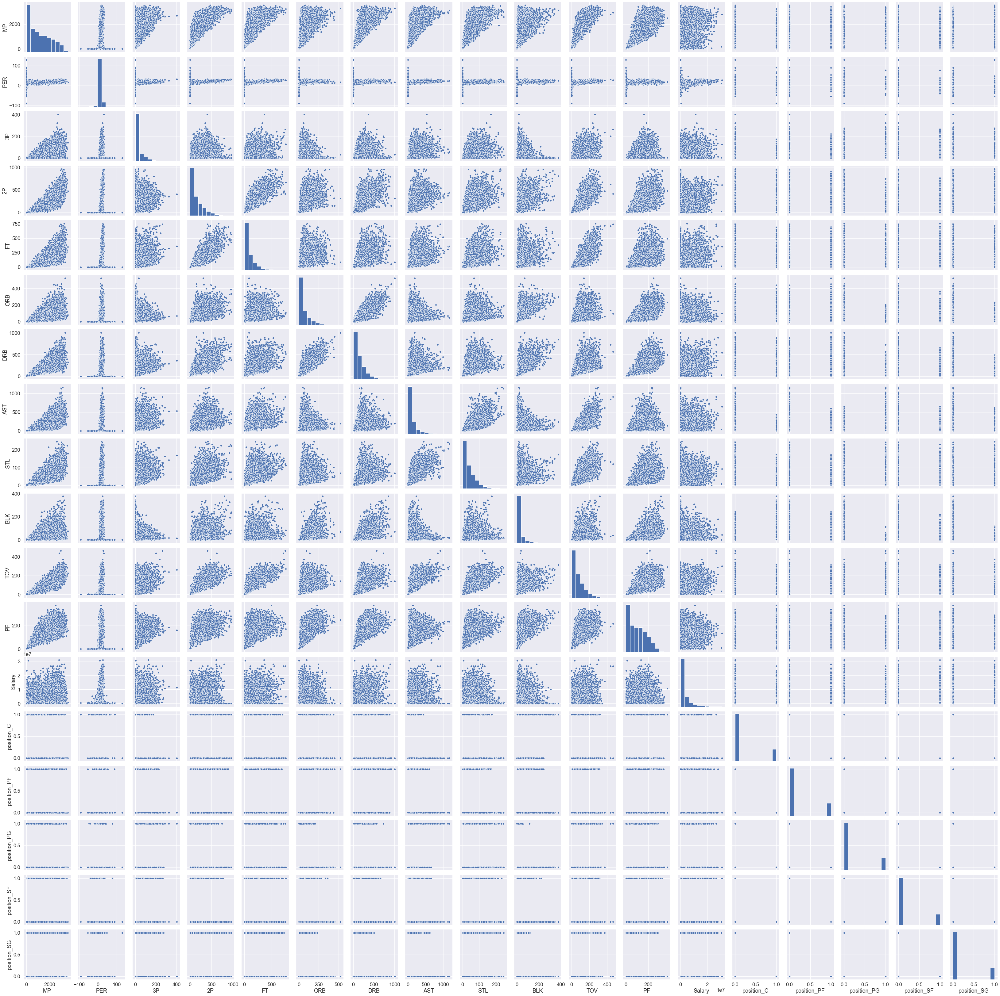

In [125]:
pairPlot(ml_Model_3_Data_With_Selected_Features)

From the above pairpolot, the independent variables are positively skewed and it is not normally distributed which can be observed along the diagonal

In [165]:
for i in ['MP', 'PER', '3P', '2P', 'FT', 'ORB', 'DRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'Salary']:
    if(ml_Model_3_Data_With_Selected_Features[i].skew() > 0.75):
        ml_Model_3_Data_With_Selected_Features[i] = np.sqrt(ml_Model_3_Data_With_Selected_Features[i])
        print(i," : ",ml_Model_3_Data_With_Selected_Features[i].skew(),"\n")

3P  :  0.11001316310449324 

AST  :  -0.24932430607542008 

BLK  :  -0.350302615682796 

Salary  :  -0.4562215286239711 



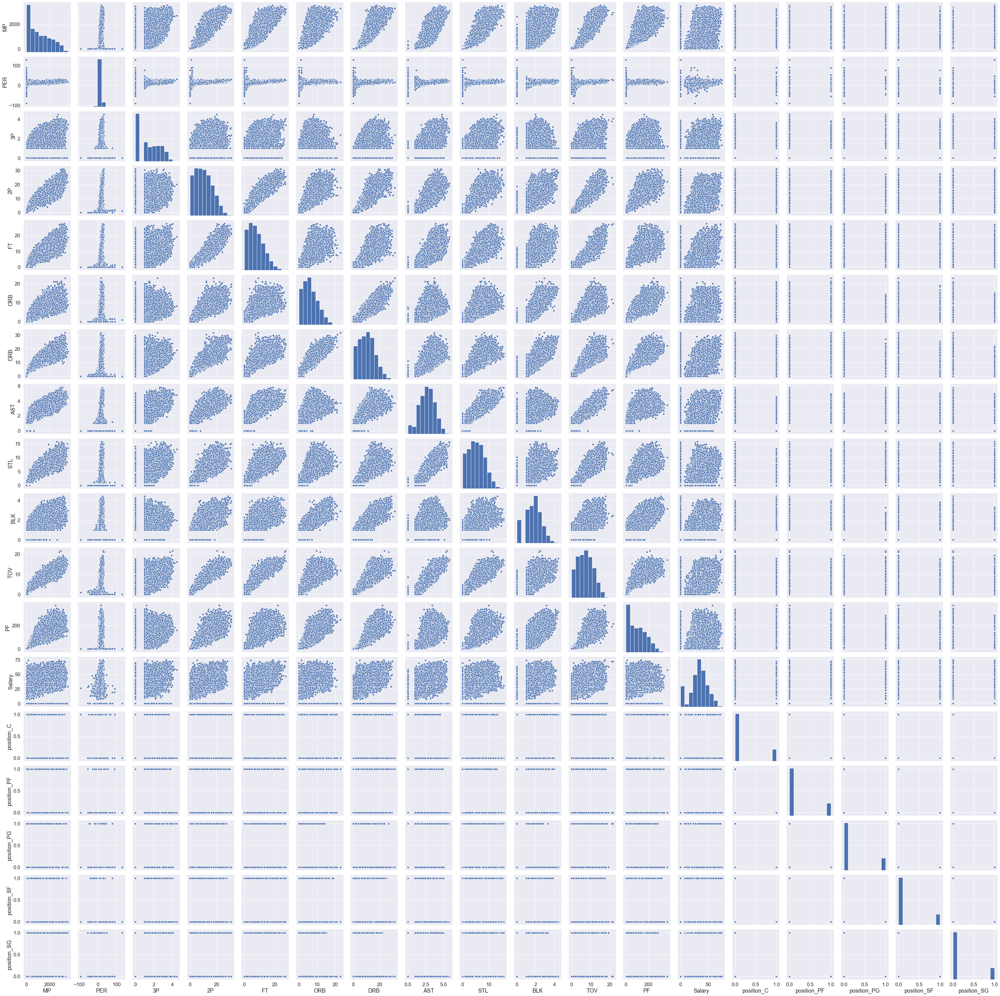

In [166]:
pairPlot(ml_Model_3_Data_With_Selected_Features)

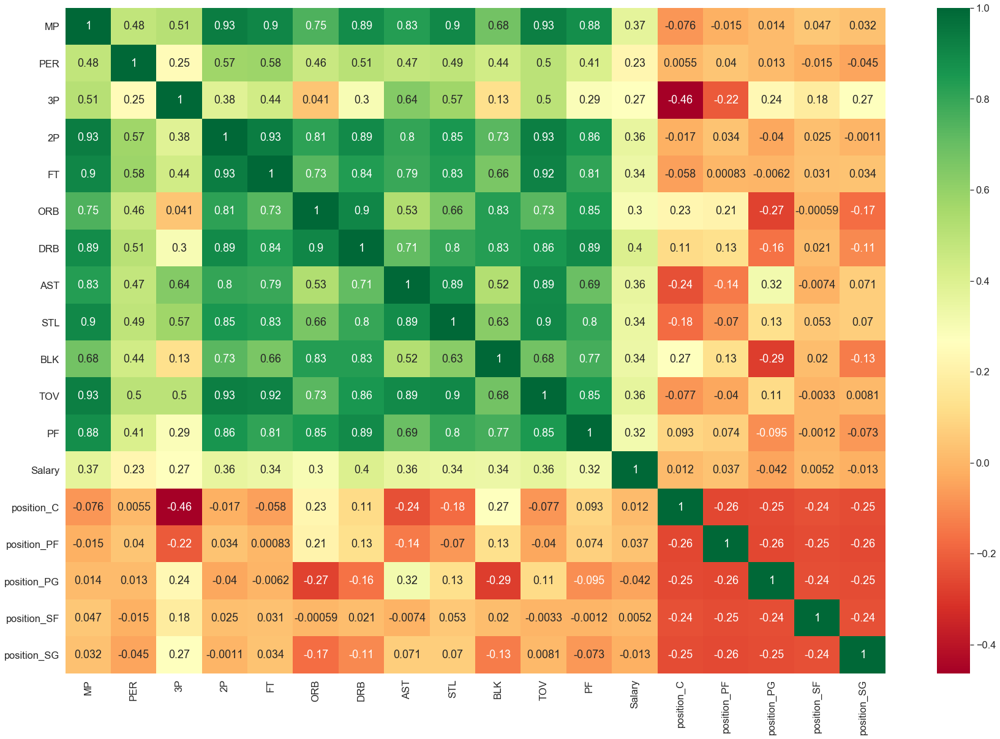

In [167]:
correlationPlot(ml_Model_3_Data_With_Selected_Features)

In [168]:
ml_Model_3_Data_With_Selected_Features.head

<bound method NDFrame.head of            MP   PER        3P         2P         FT        ORB        DRB  \
0      1691.0   8.3  1.316074  11.618950   9.110434  12.409674  16.643317   
1      2690.0  15.4  3.545392  15.491933  16.340135   7.000000  13.266499   
2      2005.0  15.8  2.359611  20.174241  13.856406  10.816654  13.711309   
3      2727.0  16.1  3.223710  19.949937  14.899664   8.306624  16.031220   
4      1893.0  14.1  1.778279  19.000000  10.392305  12.288206  14.933185   
...       ...   ...       ...        ...        ...        ...        ...   
15112  1725.0  16.7  0.000000  15.905974  11.532563  11.618950  16.431677   
15113   525.0  13.0  0.000000   8.831761   4.690416   6.557439   9.000000   
15114   108.0   7.3  0.000000   3.162278   1.732051   3.316625   4.898979   
15115   843.0   6.9  2.396782   7.416198   5.567764   3.872983  10.488088   
15116   609.0  17.0  0.000000  11.224972   5.656854   6.403124  10.862780   

            AST        STL       BLK        T

In [ ]:
multicollinearity_Check_Data = ml_Model_3_Data.shape.copy()
multicollinearity_Check_Data.rename(columns={"3P":"threePts","2P":"twoPts"},inplace=True)
#multicollinearity_Check_Data = pd.get_dummies(multicollinearity_Check_Data,columns=['Pos'])

In [162]:
vif_Calculate(ml_Model_3_Data_With_Selected_Features)

SyntaxError: invalid syntax (<unknown>, line 1)

There will be three multiple linear regression models and they are;
* <b>Model 1</b> with all features.
* <b>Model 2</b> with selected features.
* <b>Model 3</b> with features which don't have multicollinearity.

In [ ]:
#All features
x_all = ml_Model_3_Data.iloc[:,1:-1]
y_all = ml_Model_3_Data.iloc[:,-1]
x_all = pd.get_dummies(x_all,columns=['Pos'])
x_all = x_all.drop("Tm",axis=1)

X_train_all, X_test_all, Y_train_all, Y_test_all = train_test_split(x_all, y_all, test_size=0.2, random_state=0)

sc_X_all = StandardScaler()
X_train_all = sc_X_all.fit_transform(X_train_all)
X_test_all = sc_X_all.transform(X_test_all)

#Selected data
x_selected = ml_Model_3_Data_With_Selected_Features.iloc[:,1:-1]
x_selected = pd.get_dummies(x_selected,columns=['Pos'])
y_selected = ml_Model_3_Data_With_Selected_Features.iloc[:,-1]

X_train_selected, X_test_selected, Y_train_selected, Y_test_selected = train_test_split(x_selected, y_selected, 
                                                                                        test_size=0.2, random_state=0)

sc_X_selected = StandardScaler()
X_train_selected = sc_X_selected.fit_transform(X_train_selected)
X_test_selected = sc_X_selected.transform(X_test_selected)

#No multicollinearity data
x_m_selected = multicollinearity_Check_Data.iloc[:,1:-1]
x_m_selected = pd.get_dummies(x_m_selected,columns=['Pos'])
y_m_selected = multicollinearity_Check_Data.iloc[:,-1]

X_train_m_selected, X_test_m_selected, Y_train_m_selected, Y_test_m_selected = train_test_split(x_m_selected, y_m_selected, 
                                                                                        test_size=0.2, random_state=0)

sc_X_m_selected = StandardScaler()
X_train_m_selected = sc_X_m_selected.fit_transform(X_train_m_selected)
X_test_m_selected = sc_X_m_selected.transform(X_test_m_selected)

In [175]:
X_train_selected, X_test_selected, Y_train_selected, Y_test_selected = train_test_split(ml_Model_3_Data_With_Selected_Features.drop(labels = ['Salary'],axis=1), ml_Model_3_Data_With_Selected_Features['Salary'], 
                                                    test_size=0.2, random_state=0)
#sc_X_selected = StandardScaler()
#X_train_selected = sc_X_selected.fit_transform(X_train_selected)
#X_test_selected = sc_X_selected.transform(X_test_selected)

#### Multiple linear regression

In [170]:
def do_LinearRegression(x_train,y_train,x_test,y_test):
    regr = linear_model.LinearRegression()
    regr.fit(x_train, y_train)
    print('Intercept:', regr.intercept_)
    print('Coefficients: \n', regr.coef_)
    pred = regr.predict(x_test)
    
    test_set_rmse = (np.sqrt(mean_squared_error(y_test, pred)))
    test_set_r2 = r2_score(y_test, pred)

    print("RMSE : ",test_set_rmse)
    print("R2 Score : ",test_set_r2)
    
#     X = sm.add_constant(x_train) # adding a constant
 
#     model = sm.OLS(y_train, X).fit()
#     predictions = model.predict(X) 

#     print_model = model.summary()
#     print("\n",print_model)

#### Model 1

In [ ]:
do_LinearRegression(X_train_all,Y_train_all,X_test_all,Y_test_all)

#### Model 2

In [176]:
do_LinearRegression(X_train_selected,Y_train_selected,X_test_selected,Y_test_selected)

Intercept: 1041645.3998456704
Coefficients: 
 [ 4.20141033e+02  4.59197725e+04  1.52771863e+04  1.68093737e+03
  2.24458672e+03 -1.59112957e+04  1.77015124e+04  4.60287101e+03
 -1.87243121e+04 -4.17930053e+03 -4.12933035e+03 -1.15609332e+04
  5.69762455e+05  2.91994406e+05 -5.53558062e+05 -8.32296034e+04
 -2.24969195e+05]
RMSE :  3200306.761077527
R2 Score :  0.2866618727098059


#### Model 3

In [ ]:
do_LinearRegression(X_train_m_selected, Y_train_m_selected, X_test_m_selected, Y_test_m_selected)